# <div align="center">**Sentinel image processing**</div>

### This notebook shows how to choose and download satellite image data from Sentinel image storage. In this notebook, it is done through CESNET [segment](https://dhr1.cesnet.cz/#/home), where one has to be registered (for free) in order to be able to download data.

#### First it is necessary to install sentinelsat and import some important packages: 

In [1]:
pip install sentinelsat

  Using cached sentinelsat-1.2.1-py3-none-any.whl (48 kB)
  Using cached geomet-1.0.0-py3-none-any.whl (28 kB)
  Using cached html2text-2020.1.16-py3-none-any.whl (32 kB)
Note: you may need to restart the kernel to use updated packages.


In [52]:
from sentinelsat import SentinelAPI, read_geojson, geojson_to_wkt
import getpass
import zipfile
from datetime import date

In [38]:
url = 'https://dhr1.cesnet.cz/'
user = 'user'
password = 'password'
api = SentinelAPI(user, password, url)
#api = SentinelAPI(input("User name for " + url), getpass.getpass(), url)

In [43]:
# search by polygon, time, and SciHub query keywords
footprint = geojson_to_wkt(read_geojson('geojson/Praha/map.geojson'))
search_date = (date(2022,8,1), date(2022, 8, 31))

products = api.query(footprint,
                     date= search_date,
                     platformname='Sentinel-2')
# convert to Pandas DataFrame
products_df = api.to_dataframe(products)

# sort and limit to first 5 sorted products
products_df_sorted = products_df.sort_values(['cloudcoverpercentage', 'ingestiondate'], ascending=[True, True])
products_df_sorted = products_df_sorted.head(2)
products_df_sorted

,title,link,link_alternative,link_icon,summary,ondemand,generationdate,ingestiondate,beginposition,endposition,...,processingbaseline,processinglevel,producttype,platformname,size,uuid,datatakesensingstart,sensoroperationalmode,tileid,hv_order_tileid
4f69bede-867d-4d26-9072-2aa64615a01a,S2A_MSIL1C_20220816T100611_N0400_R022_T33UVR_2...,https://dhr1.cesnet.cz/odata/v1/Products('4f69...,https://dhr1.cesnet.cz/odata/v1/Products('4f69...,https://dhr1.cesnet.cz/odata/v1/Products('4f69...,"Date: 2022-08-16T10:06:11.024Z, Instrument: MS...",false,2022-08-16 13:51:25,2022-08-16 17:01:59.010,2022-08-16 10:06:11.024,2022-08-16 10:06:11.024,...,04.00,Level-1C,S2MSI1C,Sentinel-2,795.26 MB,4f69bede-867d-4d26-9072-2aa64615a01a,2022-08-16 10:06:11.024,INS-NOBS,33UVR,UR33V
41baaa5d-d501-4f20-8d7e-9e5c80c639c4,S2A_MSIL2A_20220816T100611_N0400_R022_T33UVR_2...,https://dhr1.cesnet.cz/odata/v1/Products('41ba...,https://dhr1.cesnet.cz/odata/v1/Products('41ba...,https://dhr1.cesnet.cz/odata/v1/Products('41ba...,"Date: 2022-08-16T10:06:11.024Z, Instrument: MS...",false,2022-08-16 16:25:57,2022-08-16 18:20:03.861,2022-08-16 10:06:11.024,2022-08-16 10:06:11.024,...,04.00,Level-2A,S2MSI2A,Sentinel-2,1.12 GB,41baaa5d-d501-4f20-8d7e-9e5c80c639c4,NaT,NaN,NaN,NaN


In [ ]:
# download sorted and reduced products
api.download_all(products_df_sorted.index)

In [60]:
file_name = products_df_sorted["title"][0] 
file_name

'S2A_MSIL1C_20220816T100611_N0400_R022_T33UVR_20220816T135125'

In [61]:
with zipfile.ZipFile(file_name + ".zip", 'r') as zip:
    zip.extractall()
    print('Done!')

Done!


### alternatevely, if you have the ID

In [4]:
image = api.download('bad111c6-4cf6-4f59-aaa0-f428a551556d') # Praha
#image = api.download('63849daf-fee3-4880-b5a0-8e033285b99e') # Olomouc
metadata = api.get_product_odata('bad111c6-4cf6-4f59-aaa0-f428a551556d', full=True)
zipfile.ZipFile(image["path"]).extractall('')

### <div align="center">**Loading image from downloaded data**</div>

In [62]:
import rasterio
import rasterio.plot as plot
from rasterio.plot import show
from xml.dom import minidom

#### Locate the folder with the image data

In [63]:
root = file_name
root
# Alternatively:
# root = metadata["title"]

'S2A_MSIL1C_20220816T100611_N0400_R022_T33UVR_20220816T135125'

In [66]:
manifest = minidom.parse(root + '.SAFE/manifest.safe')
items = manifest.getElementsByTagName('fileLocation')
for elem in items:
    if elem.attributes['href'].value.find("TCI") != -1:
        path = elem.attributes['href'].value
indx = path.rfind("IMG_DATA/") + len("IMG_DATA/")
root_path = path[1:indx]
img_id = path[indx:]
image_path = root + ".SAFE" + root_path
tci = rasterio.open(image_path + img_id, driver='JP2OpenJPEG')

### We can show satellite image in the notebook, but be careful, it will take about 4 minutes to render!

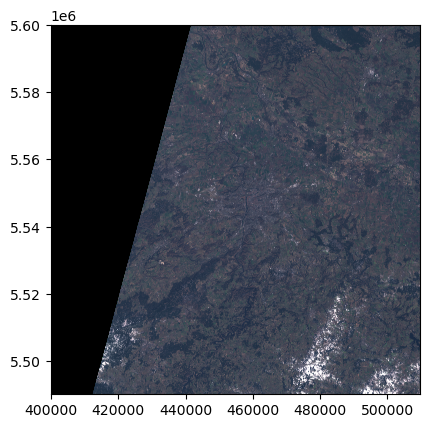

CPU times: user 5min 42s, sys: 1min 29s, total: 7min 11s
Wall time: 3min 54s


<AxesSubplot: >

In [16]:
%%time
# This takes quite a long time to execute
show(tci)

#### <div align="center">**Position of selected image in OpenStreet Maps**</div>

#### We can check whether we really downloaded satellite image data of our interest using OpenStreet maps.

In order to show we need to use some predefined functions to play a little bit with the metadata and coordinates of the satelite image.

In [67]:
import folium
from rasterio import warp
from use_functions import reverse_coordinates, to_index, generate_polygon, pol_to_np, pol_to_bounding_box

In [68]:
# original bounds of the image
bounds_trans_original = warp.transform_bounds(tci.crs,{'init': 'epsg:4326'},
                                              *tci.bounds)
polygon_trans_original = generate_polygon(bounds_trans_original)

polyline_polygon_trans_original = folium.PolyLine(reverse_coordinates(polygon_trans_original),
                                                  popup="polygon_trans_original",
                                                  color="green")#"#2ca02c")

In [69]:
mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0
map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)
map_bb.add_child(polyline_polygon_trans_original)
map_bb

### We can now create our region of interest which is Olomouc using [geojson.io](https://geojson.io) and store it the Olomouc.geojson file

In [70]:
import geojson

# Open geojson file with GPS coordinates
with open("geojson/Praha/map.geojson") as f:
    gj = geojson.load(f)

# Load coordinates from geojson file
coor = gj['features'][0]['geometry']['coordinates']

k = 0
cord = [[0] for i in range(len(coor[0]))]
for i in range(len(coor)):
    for j in range(len(coor[0])):
        cord[k] = coor[i][j]
        k += 1

In [71]:
polyline_pol_clip = folium.PolyLine(reverse_coordinates(cord), popup="cord",color="red")

In [72]:
mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0
map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)
map_bb.add_child(polyline_polygon_trans_original)
map_bb.add_child(polyline_pol_clip)
map_bb

#### We can also show the region of interest within the satelite image, but we need to convert the coordinates using some predefined functions

In [73]:
from bbox_converter import bbox_converter
bbox_converter("geojson/Praha/map.geojson","geojson/Praha/praha_bbox_test.geojson",32633)

The file geojson/Praha/praha_bbox_test.geojson has been saved!


In [76]:
import geopandas as gpd
gdf = gpd.read_file("geojson/Praha/praha_bbox_test.geojson")
Praha_geo = "geojson/Praha/praha_bbox_test.geojson"

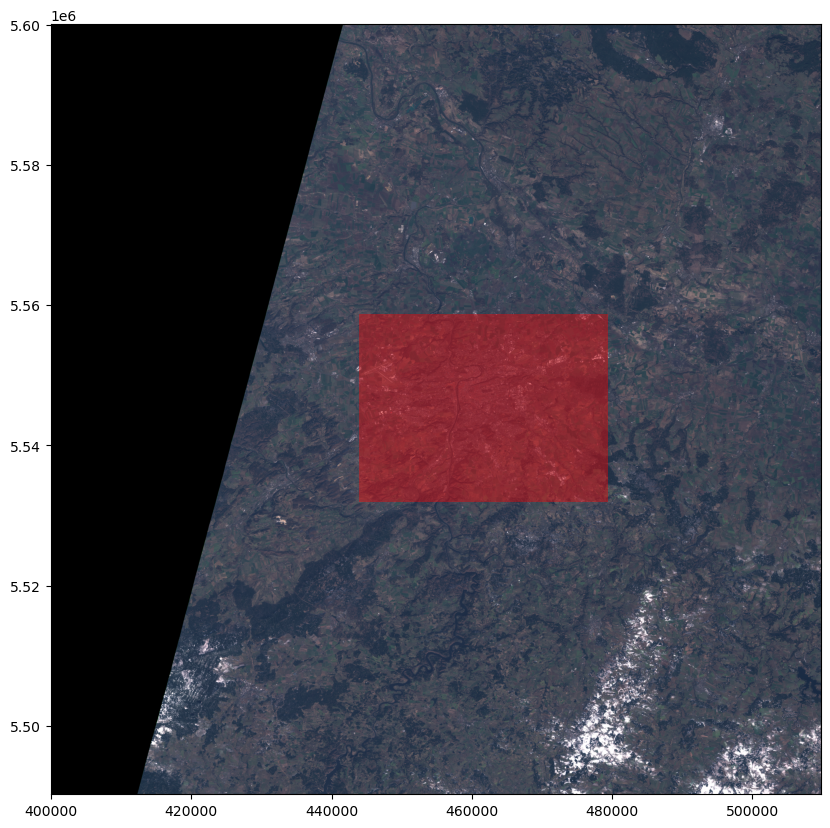

CPU times: user 5min 55s, sys: 1min 28s, total: 7min 24s
Wall time: 3min 57s


In [25]:
%%time
import matplotlib.pyplot as plt

# This takes quite a long time to execute
fig, ax = plt.subplots(figsize=(12, 10))
show(tci,ax=ax)
gdf.plot(ax=ax, color='red', alpha=.4, aspect=1)
plt.show()

### <div align="center">**Insert clipped Sentinel image in OpenStreet Map**</div>

In [78]:
import pyproj
import numpy as np
import json
import rasterio
from rasterio.plot import show
from rasterio import windows
from matplotlib import pyplot as plt
from image_clip import clipper
import os

In [79]:
path_folder = "Praha_sunny/"
#path = os.path.join(directory, folder_prg)
os.mkdir(path_folder)
clipper(image_path,Praha_geo,path_folder)

All clipped images are saved in Praha_sunny/ folder!


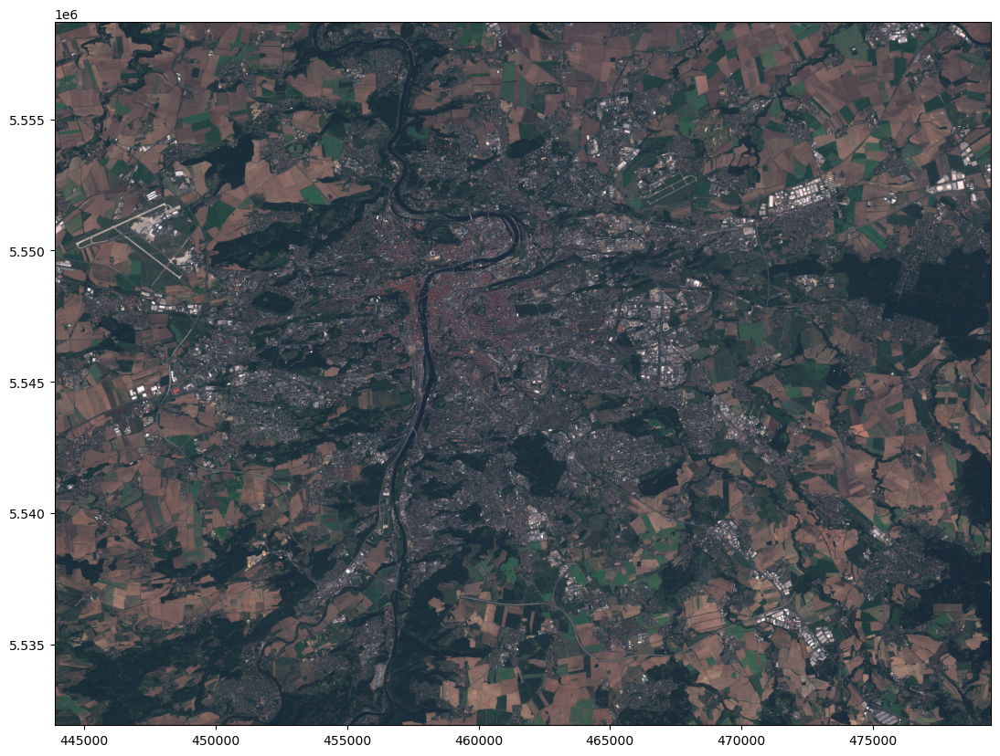

<AxesSubplot: >

In [80]:
clip = path_folder + "TCI.tif"
plt.figure(figsize=(15,10))
clipped_img = rasterio.open(clip)
show(clipped_img)

In [81]:
clipped_img = rasterio.open(clip)
# Read img and convert to numpy stack
img = np.stack([clipped_img.read(i) for i in range(1,4)], axis=-1)

In [82]:
bbox = pol_to_bounding_box(cord)
bounds_trans = warp.transform_bounds({'init': 'epsg:4326'},clipped_img.crs,*bbox)
pol_bounds_trans = generate_polygon(bounds_trans)

bbox = pol_to_bounding_box(pol_bounds_trans)
window_same = windows.from_bounds(*bbox,clipped_img.transform)
transform_window = windows.transform(window_same,clipped_img.transform)

In [83]:
transform,width,height = warp.calculate_default_transform(clipped_img.crs, {"init":"epsg:4326"},
                                                          img.shape[1],img.shape[0],
                                                          left=bbox[0],bottom=bbox[1],
                                                          right=bbox[2],top=bbox[3])
                                                          #resolution=0.002)

out_array = np.ndarray((img.shape[2],height,width),dtype=img.dtype)

In [84]:
warp.reproject(np.transpose(img,axes=(2,0,1)),
               out_array,
               src_crs=clipped_img.crs,
               dst_crs={"init":"epsg:4326"},
               src_transform=transform_window,
               dst_transform=transform,
               resampling=warp.Resampling.bilinear);

#plt.figure(figsize=(8,8))
#plot.show(out_array, transform=transform)


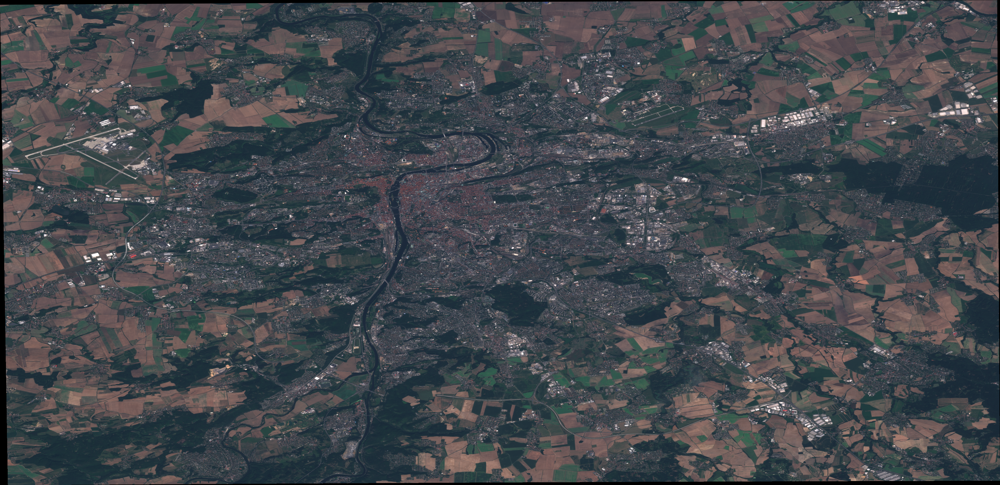

In [85]:
bbox_clip = pol_to_bounding_box(cord)

mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0

map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)

map_bb.add_child(polyline_polygon_trans_original)
map_bb.add_child(polyline_pol_clip)
image_overlay = folium.raster_layers.ImageOverlay(np.transpose(out_array,(1,2,0)),
                                                  [[bbox_clip[1],
                                                    bbox_clip[0]],
                                                   [bbox_clip[3],
                                                    bbox_clip[2]]])
map_bb.add_child(image_overlay)
map_bb